# Zadanie domowe

W przypadku obrazów w odcieniach szarości pojedynczy piksel z zakresu [0; 255] reprezentowany jest jako 8-bitowa liczba bez znaku.
Pewnym rozszerzeniem analizy sposobu reprezentacji obrazu może być następujący eksperyment.
Załóżmy, że z każdego z 8 bitów możemy stworzyć pojedynczy obraz binarny (ang. _bit-plane slicing_).
Dla obrazka _100zloty.jpg_ (https://raw.githubusercontent.com/vision-agh/poc_sw/master/02_Point/100zloty.jpg) stwórz 8 obrazów, z których każdy powinien zawierać jedną płaszczyznę bitową.
Podpowiedź $-$ warto sprawdzić, jak realizuje się bitowe operacje logiczne.
Zastosowanie takiej dekompozycji obrazu pozwala na analizę ,,ważności'' poszczególnych bitów.
Jest to użyteczne w kwantyzacji, ale także w kompresji.

W drugim etapie zadania proszę spróbować odtworzyć obraz oryginalny z mniejszej liczby obrazów binarnych.
Warto zacząć od dwóch najbardziej znaczących bitów, a później dodawać kolejne.
Należy utworzyć co najmniej trzy wersje zrekonstruowanych obrazów.
Podpowiedź $-$ rekonstrukcja obrazu to mnożenie przez odpowiednią potęgę liczby 2 (przesunięcie bitowe) oraz dodawanie.

In [1]:
import cv2
import os
import requests
import matplotlib.pyplot as plt

url = 'https://raw.githubusercontent.com/vision-agh/poc_sw/master/02_Point/'
fileName = '100zloty.jpg'

if not os.path.exists(fileName) :
    r = requests.get(url + fileName, allow_redirects = True)
    open(fileName, 'wb').write(r.content)

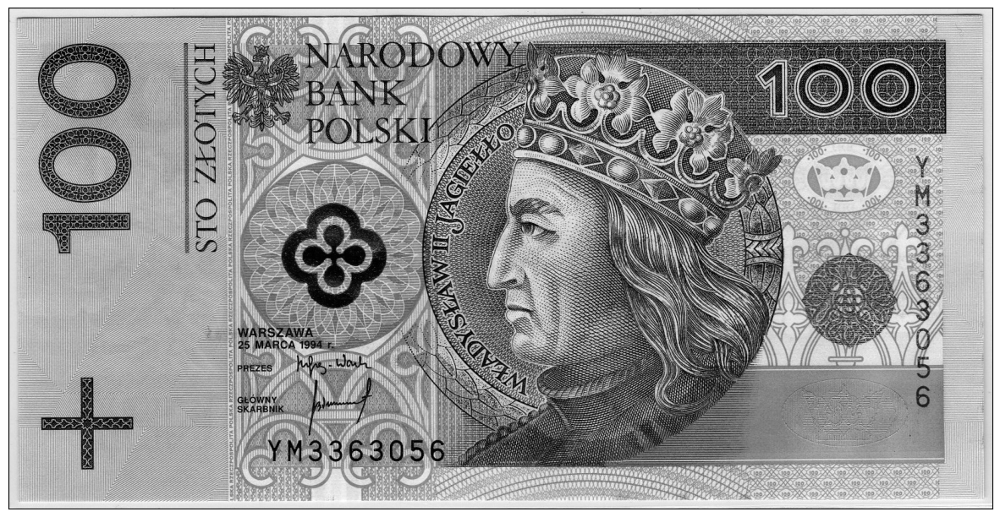

In [2]:
stowa = cv2.imread(fileName, cv2.IMREAD_GRAYSCALE)

plt.figure(figsize = (15, 10))
plt.imshow(stowa, cmap = "gray")
plt.xticks([]), plt.yticks([])
plt.show()

## Podział na płaszczyzny bitowe

In [3]:
import numpy as np

no_planes = 8
planes = [np.zeros(stowa.shape, dtype = np.uint8) for _ in range(no_planes)]

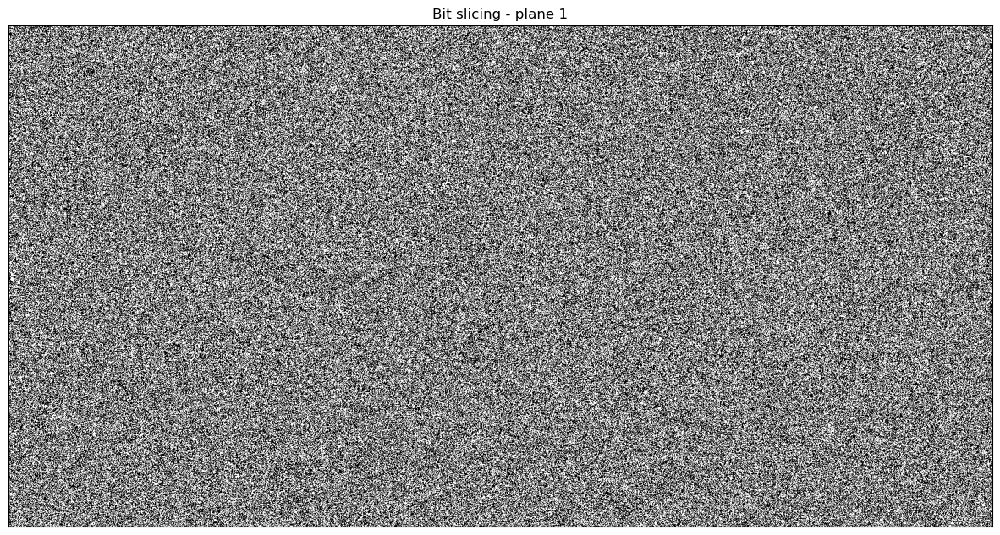

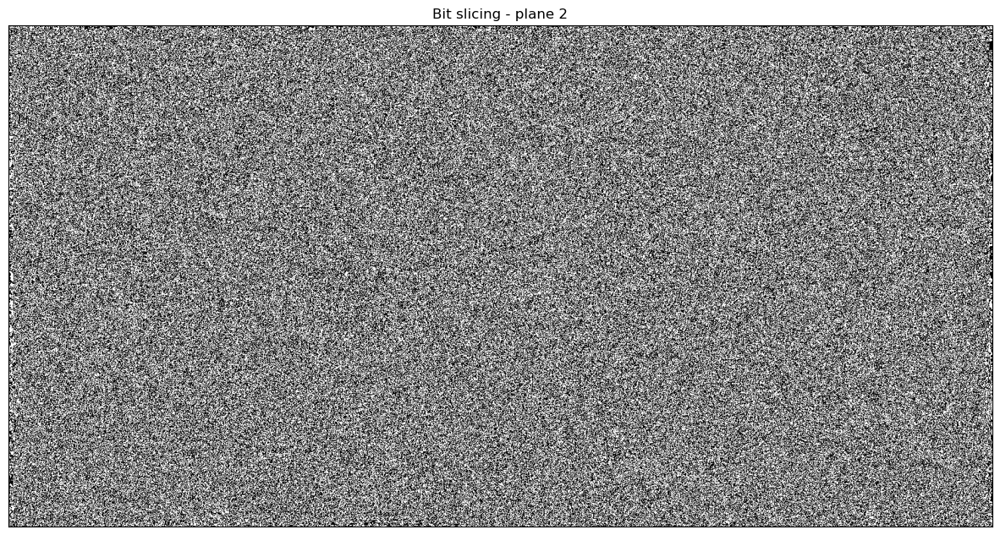

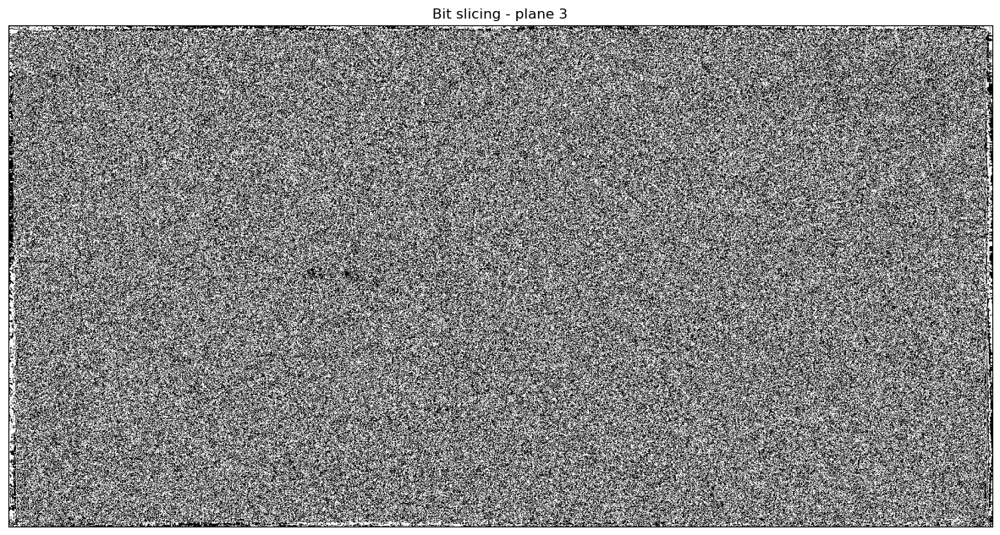

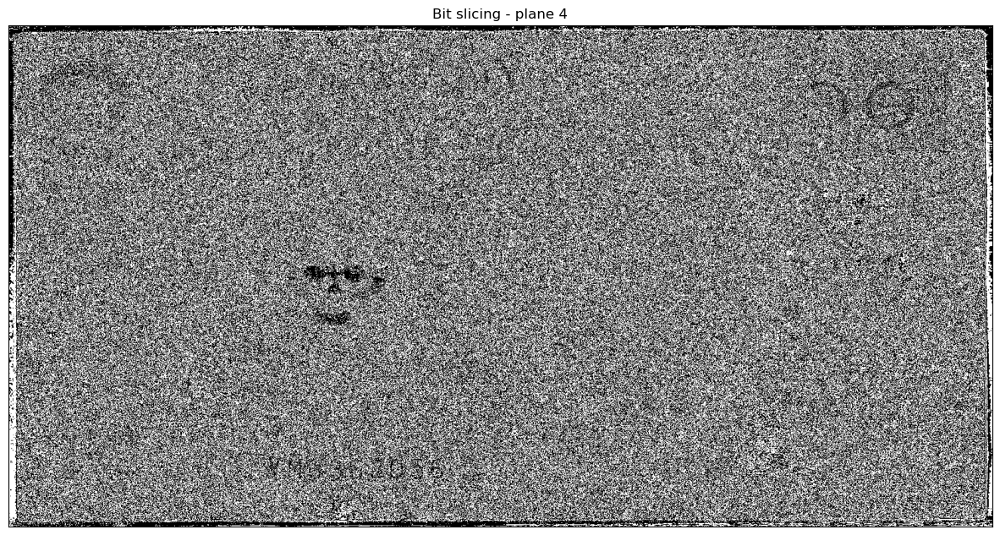

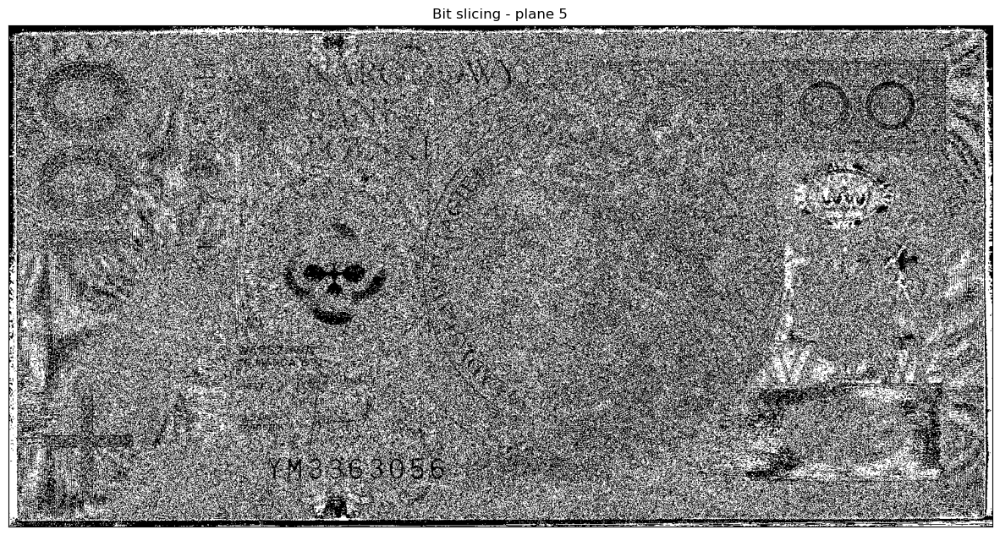

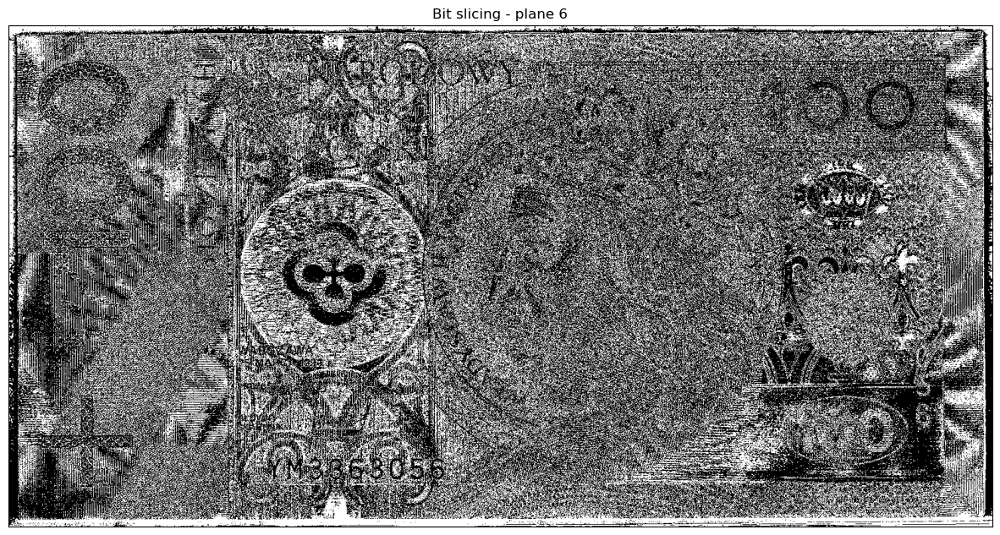

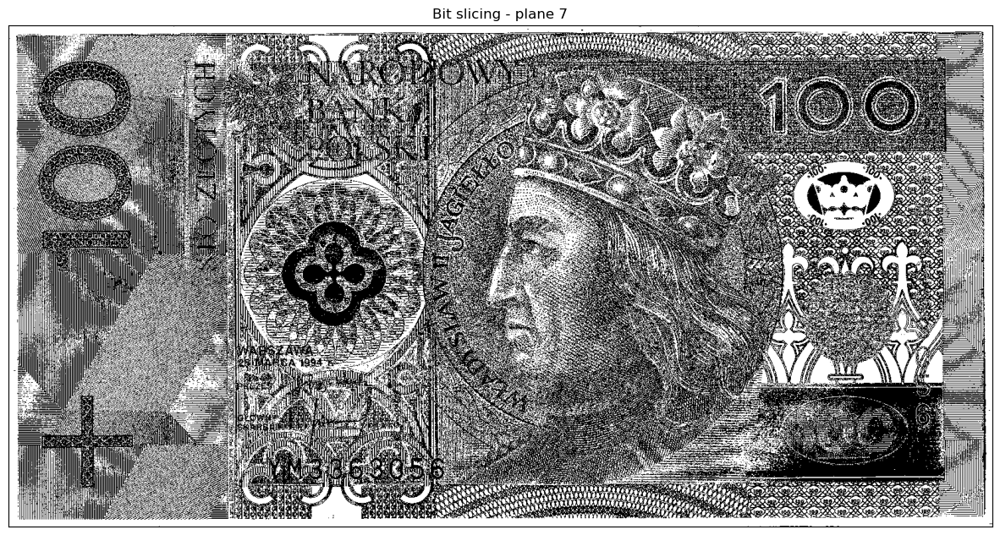

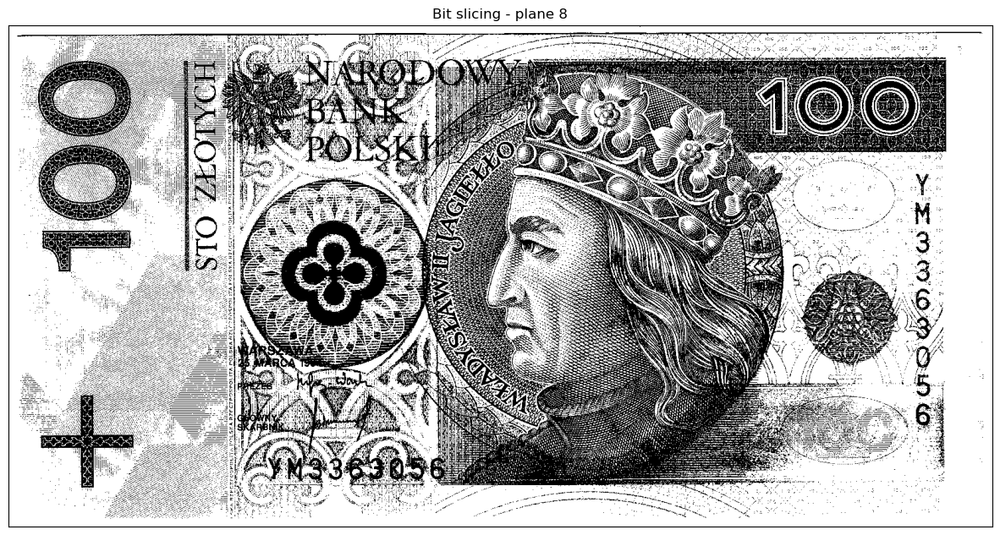

In [4]:
for i in range(no_planes):
    mask = 1 << i
    planes[i] = (stowa & mask) >> i

    plt.figure(figsize = (15, 10))
    plt.imshow(planes[i], cmap = "gray")
    plt.xticks([]), plt.yticks([])
    plt.title(f"Bit slicing - plane {i+1}")
    plt.show()

## Rekonstrukcja obrazu oryginalnego

In [5]:
bity_rek = [6, 3, 0]

stowa_rek = np.zeros(stowa.shape, dtype = np.uint8)

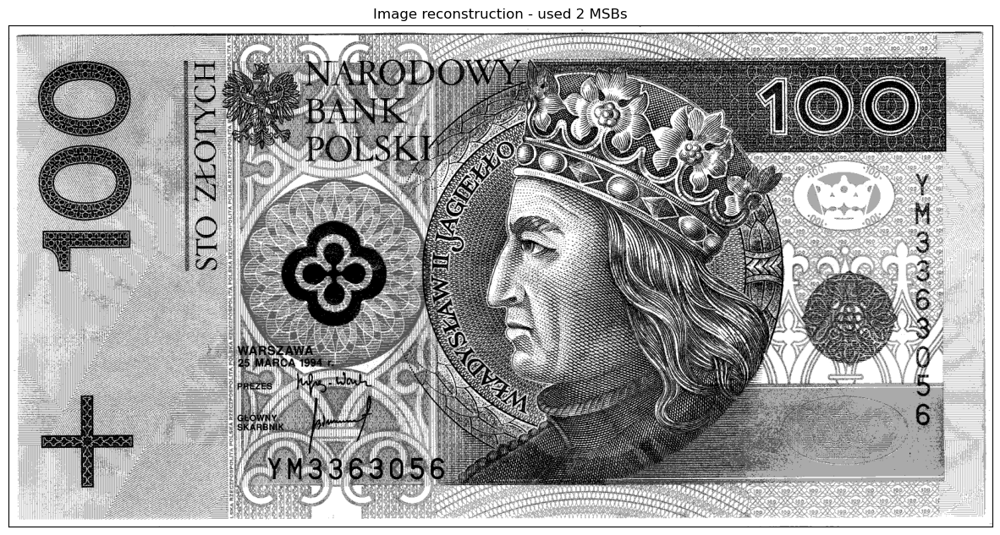

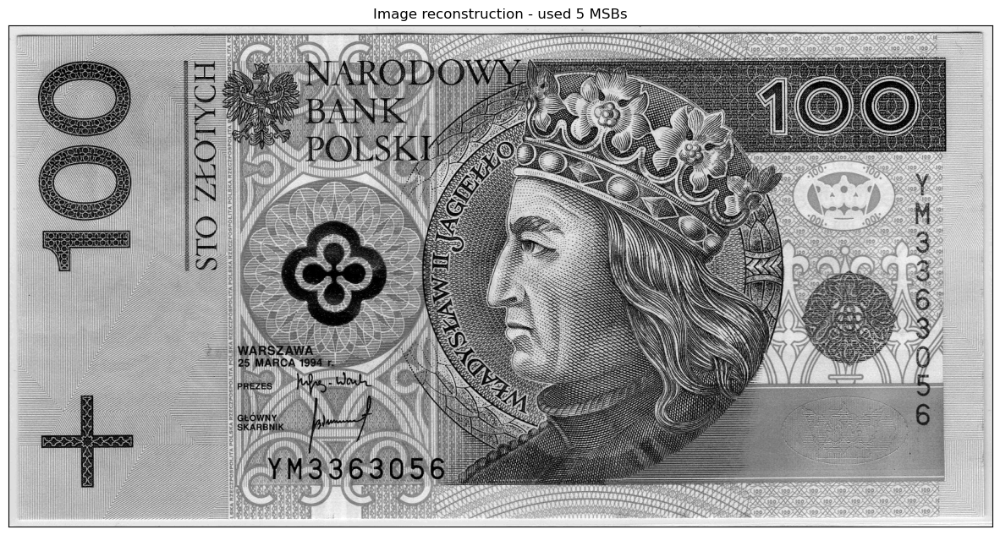

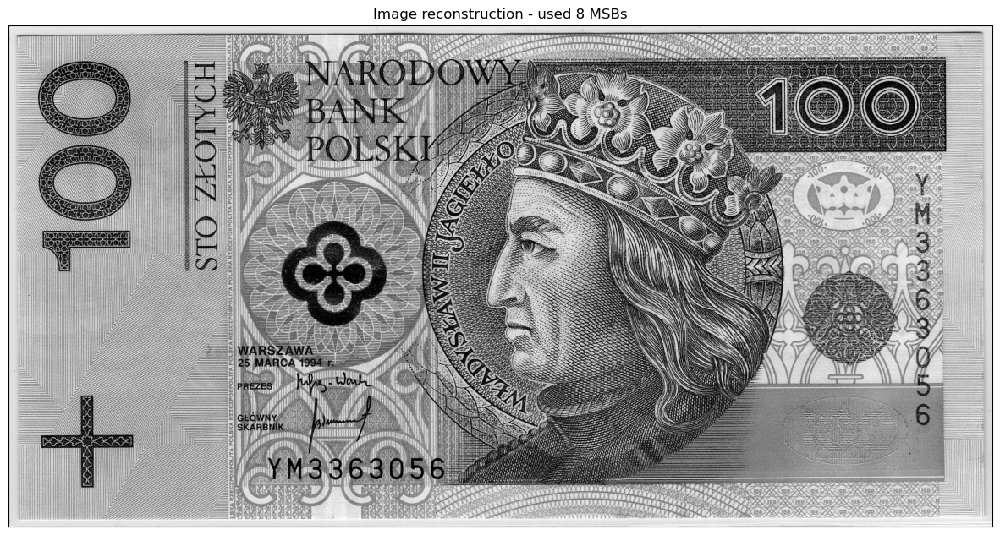

In [6]:
for i in range(no_planes-1, -1, -1):
    stowa_rek = stowa_rek + 2 ** i * planes[i]

    if i in bity_rek:
        plt.figure(figsize = (15, 10))
        plt.imshow(stowa_rek, cmap = "gray")
        plt.xticks([]), plt.yticks([])
        plt.title(f"Image reconstruction - used {no_planes-i} MSBs")
        plt.show()